# Simple object detection methods

In [1]:
import numpy as np
import cv2 as cv
from numba import jit
from PIL import Image
from IPython.display import display

In [2]:
def show_image(image, rect = None):
    img_copy = cv.cvtColor(image,cv.COLOR_BGR2RGB)
    if rect is not None:
        cv.rectangle(img_copy,rect[0], rect[1], (255, 0, 0), 3)
    display(Image.fromarray(img_copy))

In [3]:
@jit
def get_diff_array(img: np.ndarray, obj: np.ndarray):
    ih, iw, oh, ow = img.shape[0], img.shape[1], obj.shape[0], obj.shape[1]
    diff = np.zeros((ih - oh, iw - ow))

    for h in range(diff.shape[0]):
        for w in range(diff.shape[1]):
            diff[h][w] = np.mean(np.abs(img[h:h+oh, w:w+ow] - obj))
    return diff

def find_object_simple(image, obj):
    img_gray = cv.cvtColor(image,cv.COLOR_BGR2GRAY)
    obj_gray = cv.cvtColor(obj,cv.COLOR_BGR2GRAY)

    diff = get_diff_array(img_gray, obj_gray)

    top_left = (np.argmin(diff) % diff.shape[1], np.argmin(diff) // diff.shape[1])
    bottom_right = (top_left[0] + obj_gray.shape[1], top_left[1]  + obj_gray.shape[0])

    return top_left, bottom_right

In [4]:
def find_object_orb(image, template, points_match=100):
    orb = cv.ORB_create(10000)
    kp1, des1 = orb.detectAndCompute(image,None)
    kp2, des2 = orb.detectAndCompute(template,None)

    bf = cv.BFMatcher(cv.NORM_HAMMING, crossCheck=True)
    matches = bf.match(des1,des2)
    matches = sorted(matches, key = lambda x:x.distance)

    point_list = [m.queryIdx for m in matches[:points_match]]
    c_list = cv.KeyPoint_convert(kp1)
    needed_c_list = np.array([c_list[p] for p in point_list])

    x = needed_c_list[:, 0]
    y = needed_c_list[:, 1]

    top_left = (int(max(x)), int(max(y)))
    bottom_right = (int(min(x)), int(min(y)))

    return top_left, bottom_right

In [5]:
class Detector:
    def __init__(self, find_function):
        self.find_function = find_function

    def detect(self, image, object_to_find):
        borders = self.find_function(image, object_to_find)
        show_image(image, borders)

In [6]:
simple_detector = Detector(find_object_simple)
orb_detector = Detector(find_object_orb)

## Part of the original image

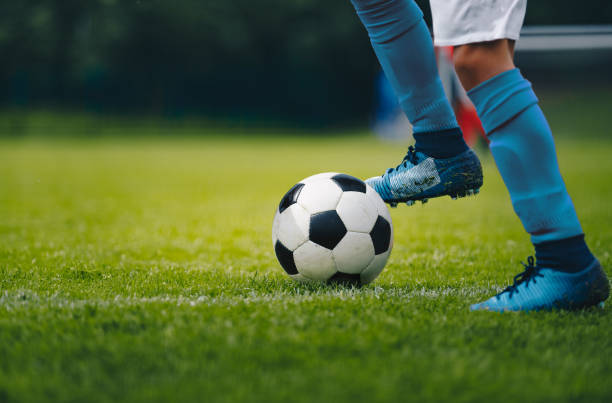

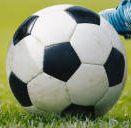

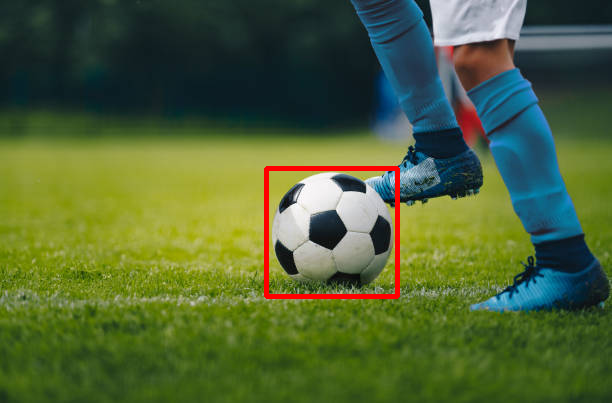

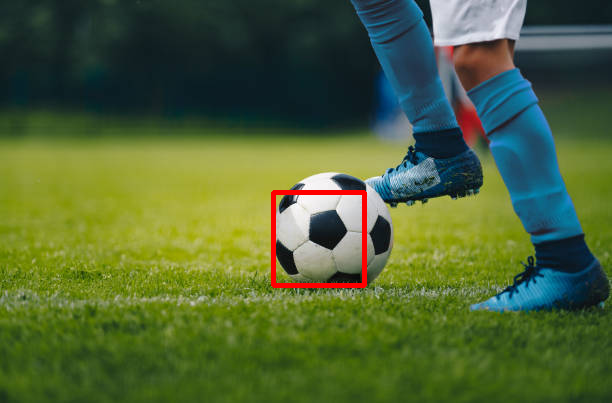

In [17]:
img = cv.imread("../data/football.jpg")
obj = cv.imread("../data/ball.png")
show_image(img)
show_image(obj)
simple_detector.detect(img, obj)
orb_detector.detect(img, obj)

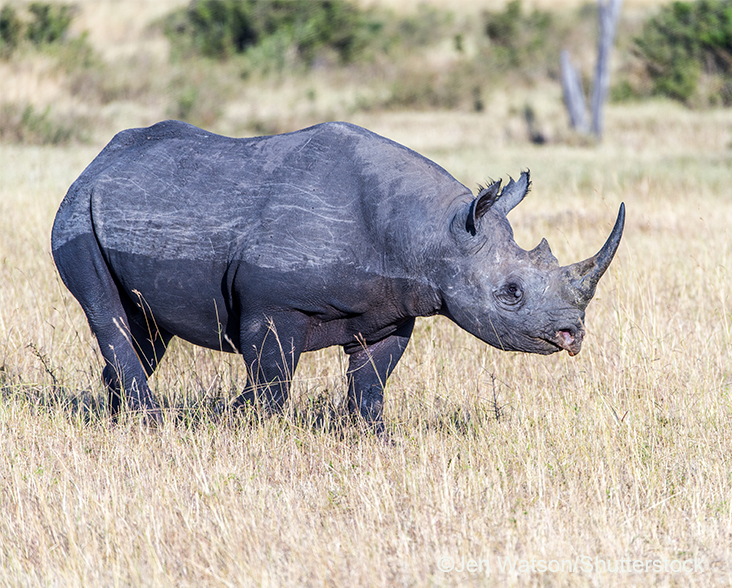

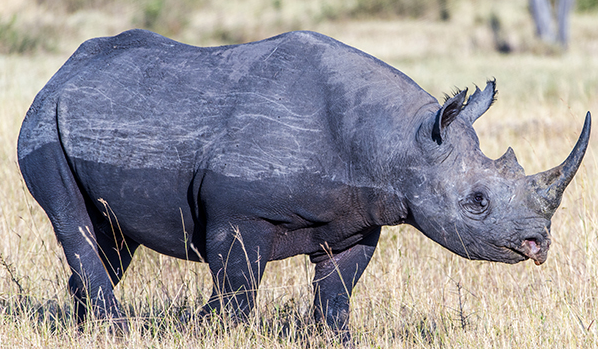

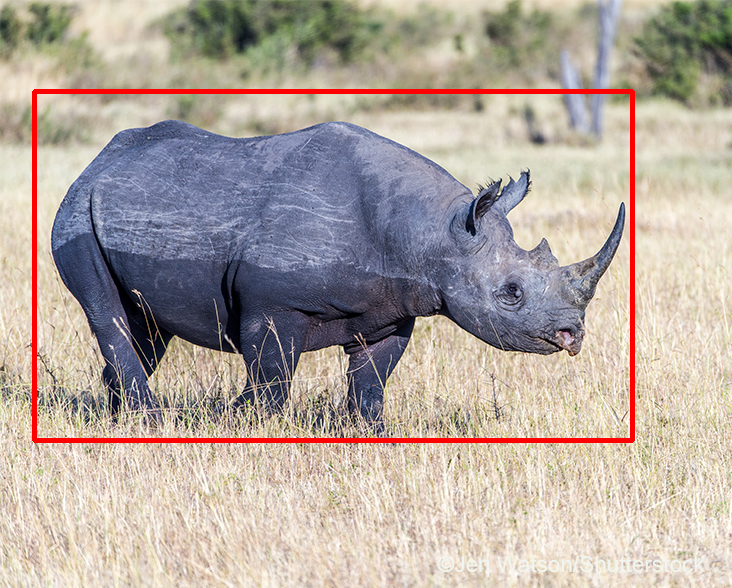

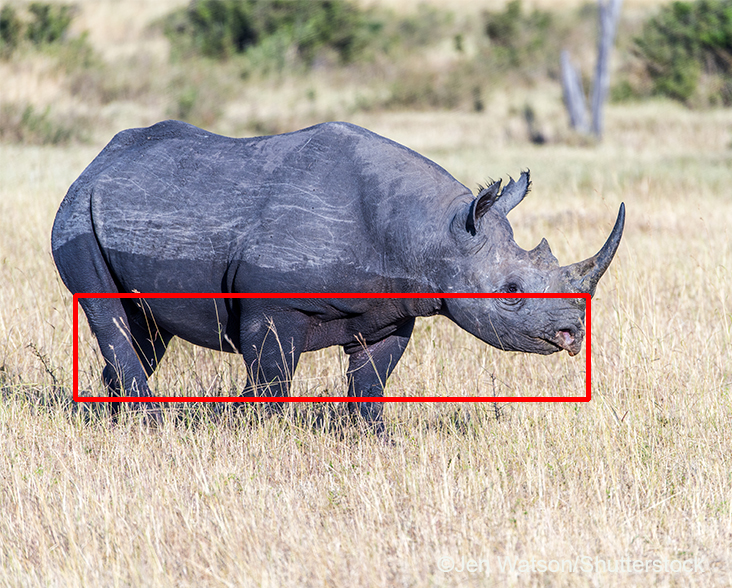

In [8]:
img = cv.imread("../data/rhino.jpg")
obj = cv.imread("../data/rhino_sample.png")
show_image(img)
show_image(obj)
simple_detector.detect(img, obj)
orb_detector.detect(img, obj)

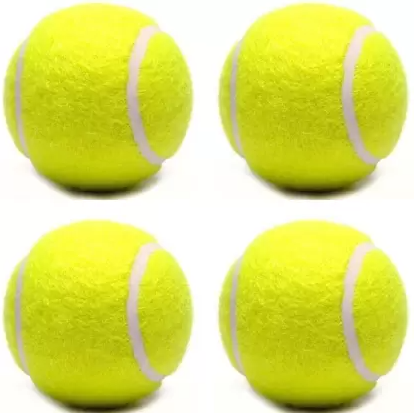

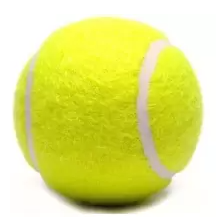

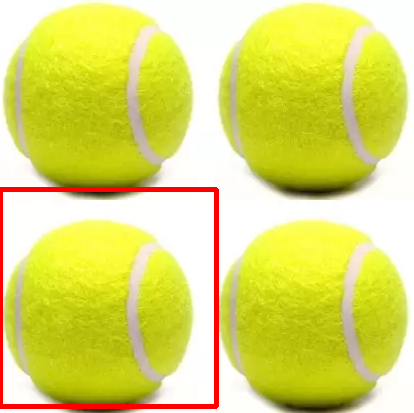

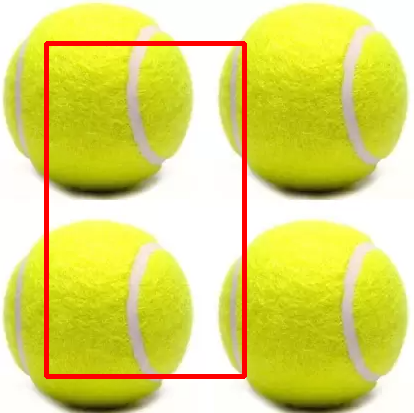

In [13]:
img = cv.imread("../data/tennis.png")
obj = cv.imread("../data/tennis_ball.png")
show_image(img)
show_image(obj)
simple_detector.detect(img, obj)
orb_detector.detect(img, obj)

## Rotating

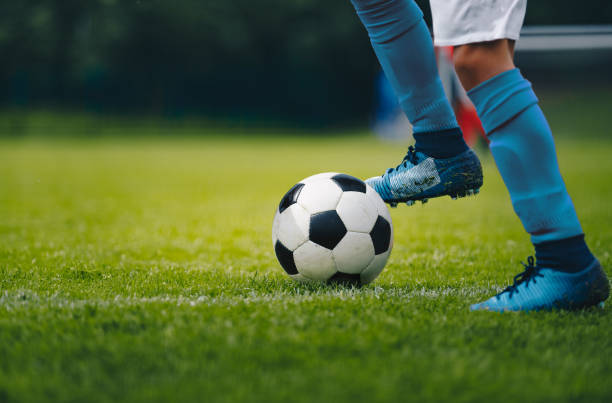

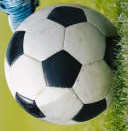

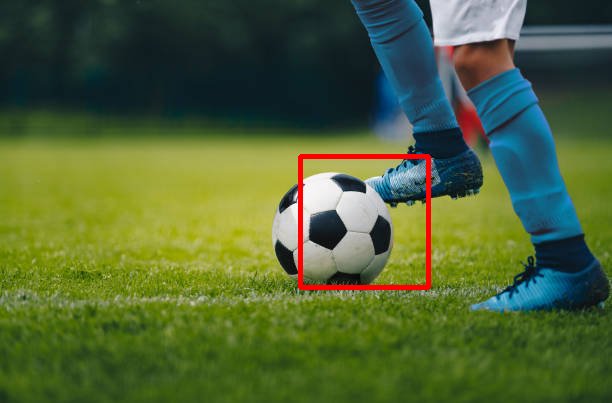

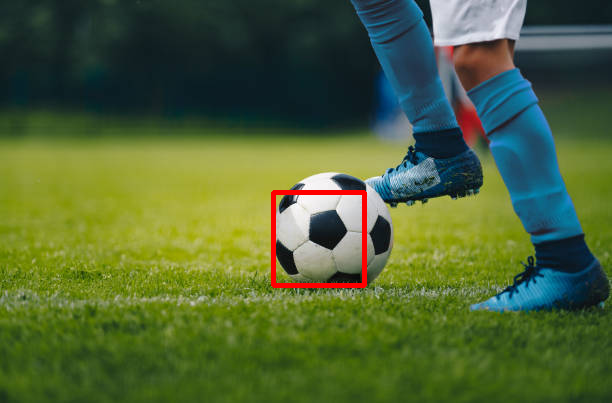

In [18]:
img = cv.imread("../data/football.jpg")
obj = cv.imread("../data/ball_rotated.png")
show_image(img)
show_image(obj)
simple_detector.detect(img, obj)
orb_detector.detect(img, obj)

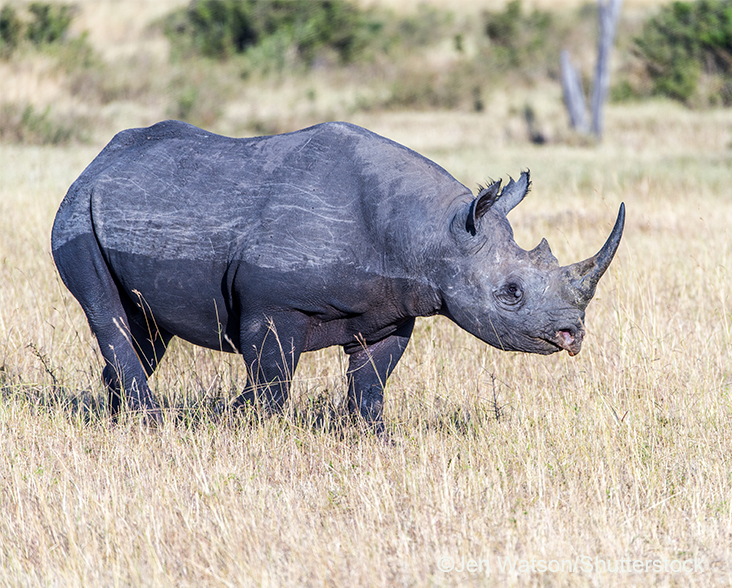

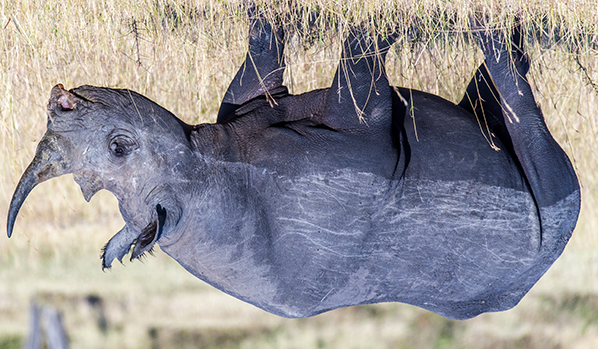

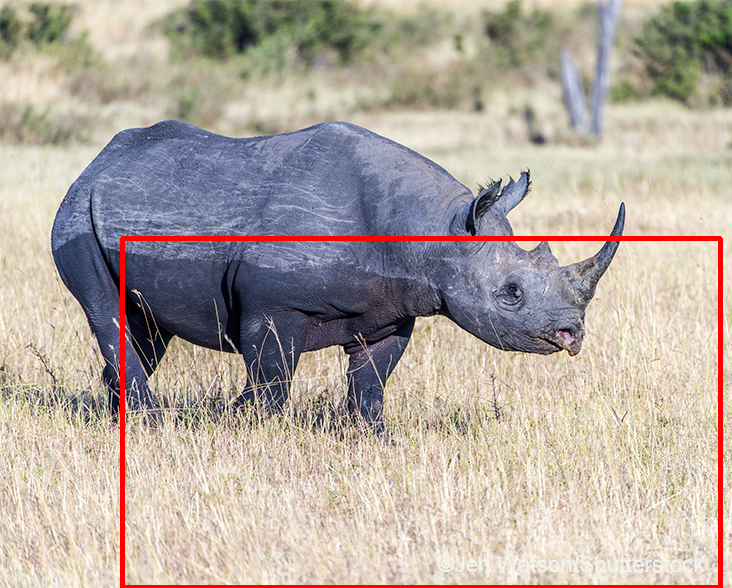

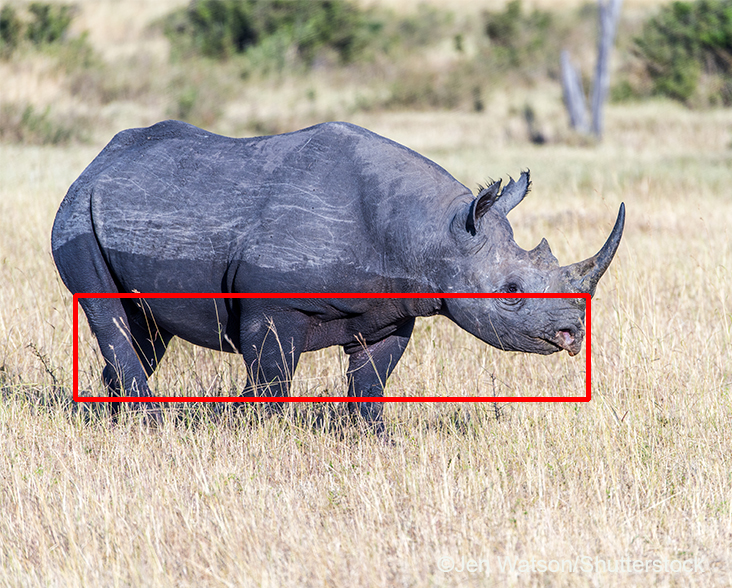

In [21]:
img = cv.imread("../data/rhino.jpg")
obj = cv.imread("../data/rhino_sample_rotated.png")
show_image(img)
show_image(obj)
simple_detector.detect(img, obj)
orb_detector.detect(img, obj)

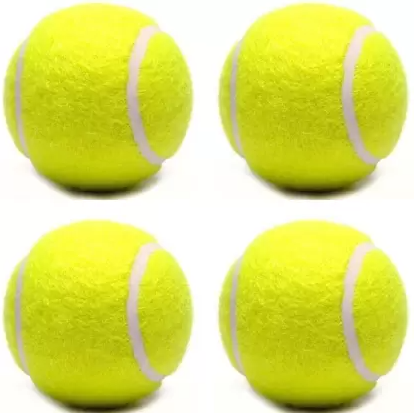

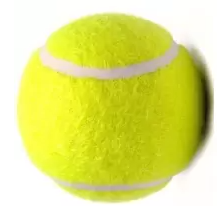

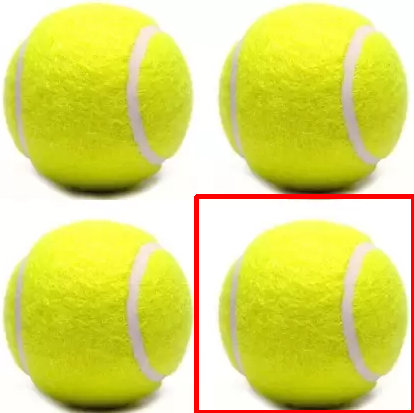

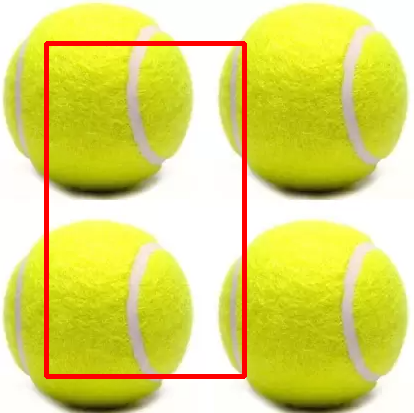

In [23]:
img = cv.imread("../data/tennis.png")
obj = cv.imread("../data/tennis_ball_rotated.png")
show_image(img)
show_image(obj)
simple_detector.detect(img, obj)
orb_detector.detect(img, obj)

## Mirroring

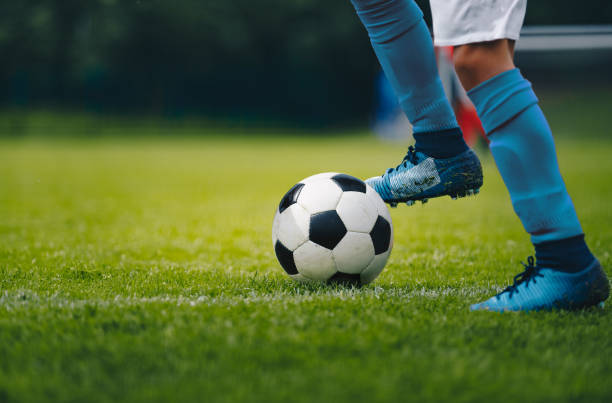

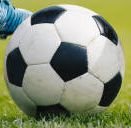

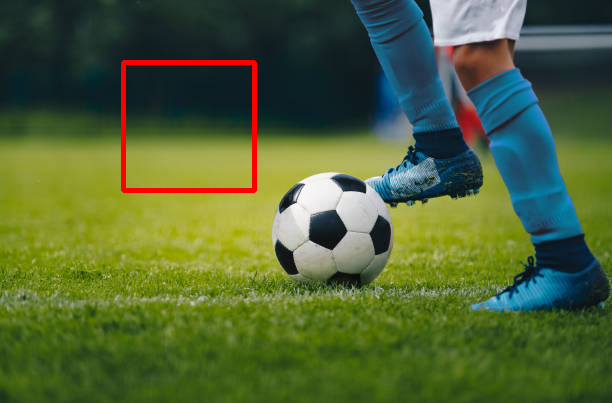

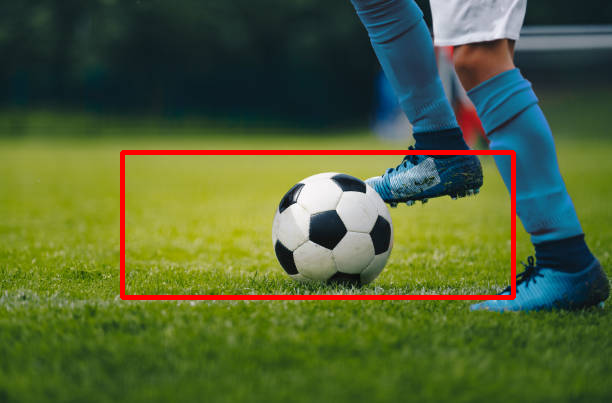

In [24]:
img = cv.imread("../data/football.jpg")
obj = cv.imread("../data/ball_mirrored.png")
show_image(img)
show_image(obj)
simple_detector.detect(img, obj)
orb_detector.detect(img, obj)

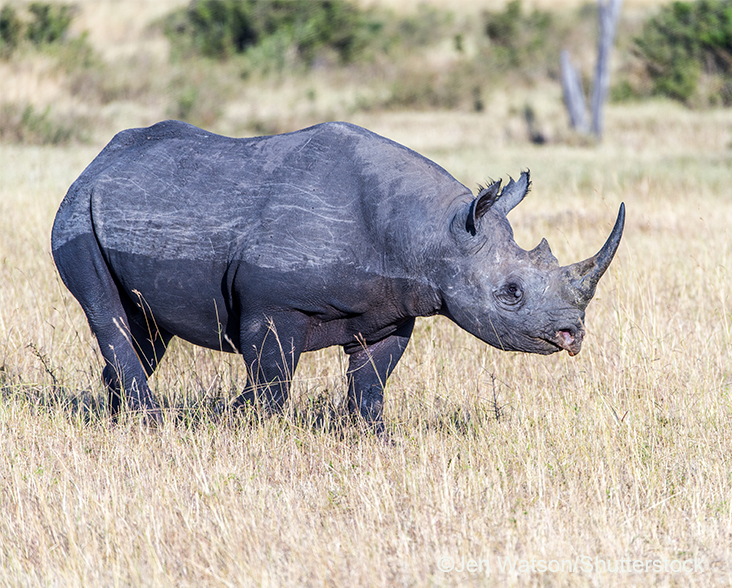

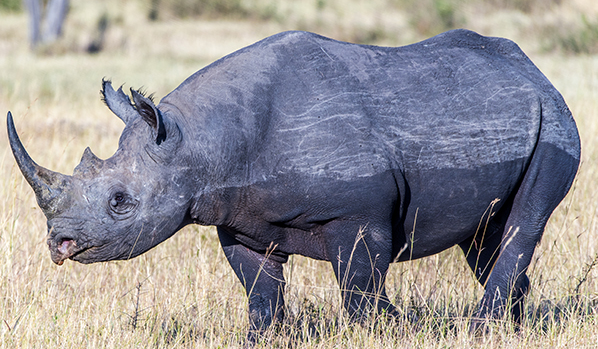

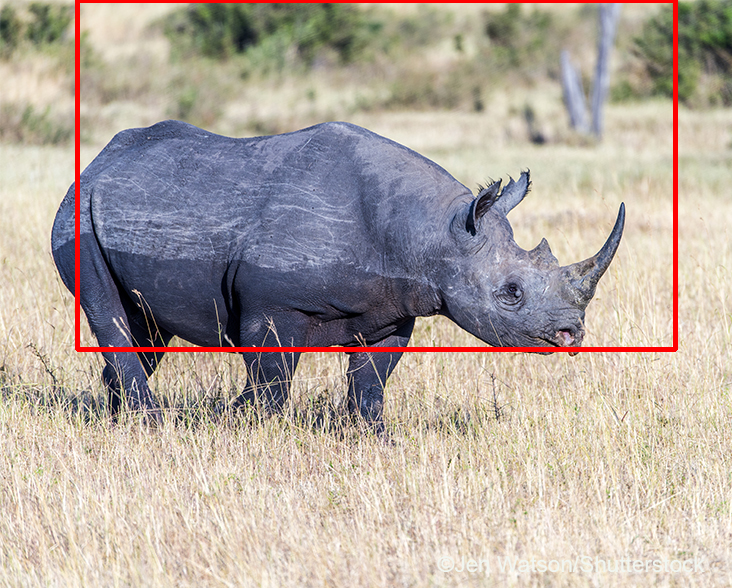

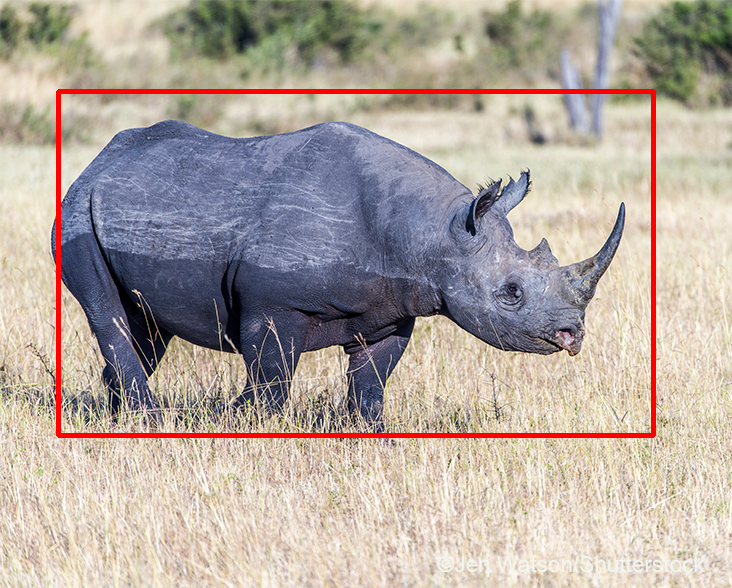

In [25]:
img = cv.imread("../data/rhino.jpg")
obj = cv.imread("../data/rhino_sample_mirrored.png")
show_image(img)
show_image(obj)
simple_detector.detect(img, obj)
orb_detector.detect(img, obj)

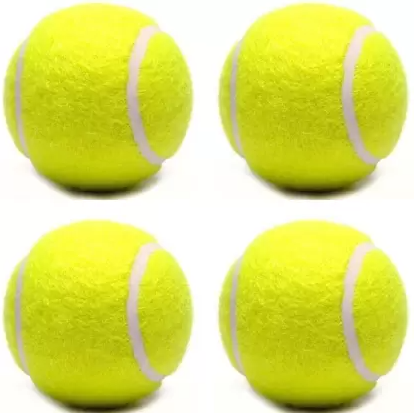

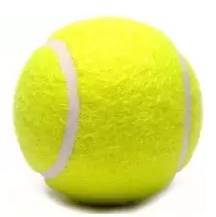

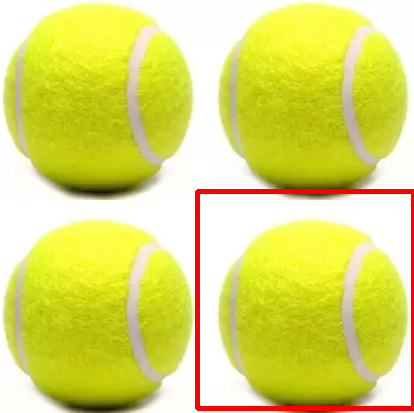

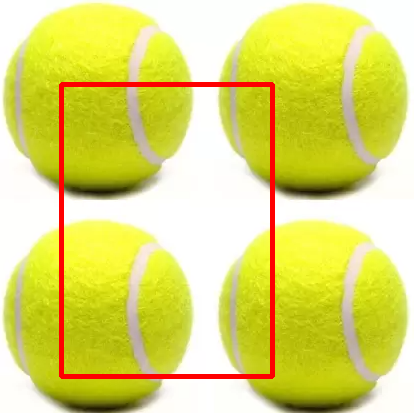

In [26]:
img = cv.imread("../data/tennis.png")
obj = cv.imread("../data/tennis_ball_mirrored.png")
show_image(img)
show_image(obj)
simple_detector.detect(img, obj)
orb_detector.detect(img, obj)

## Brightness change

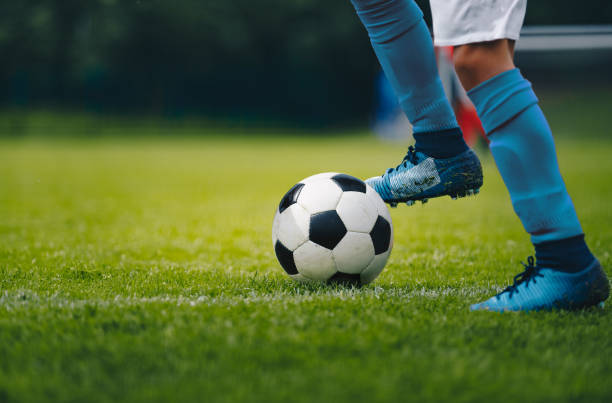

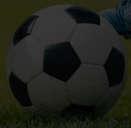

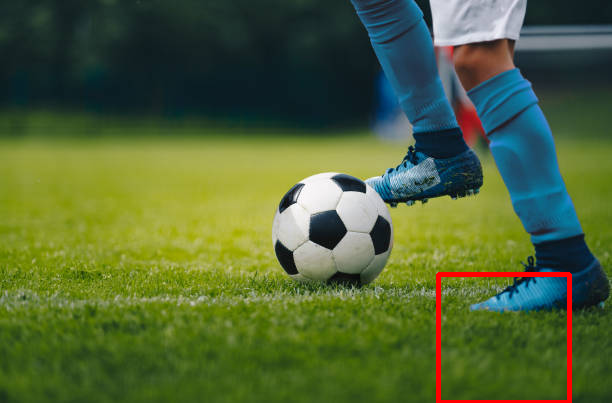

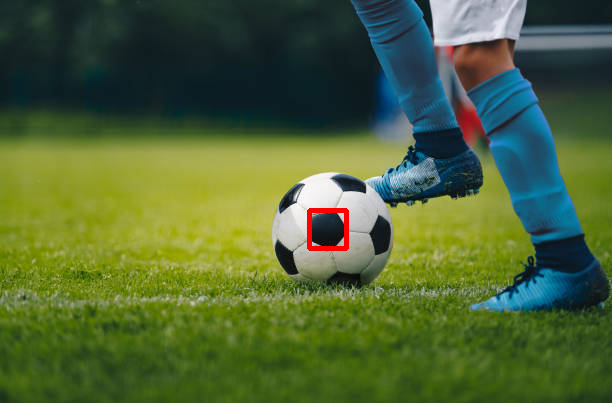

In [27]:
img = cv.imread("../data/football.jpg")
obj = cv.imread("../data/ball_brightness.png")
show_image(img)
show_image(obj)
simple_detector.detect(img, obj)
orb_detector.detect(img, obj)

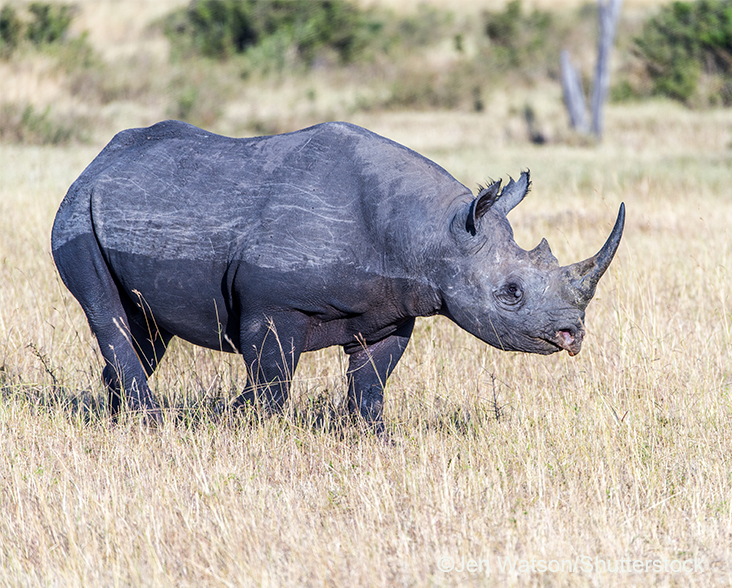

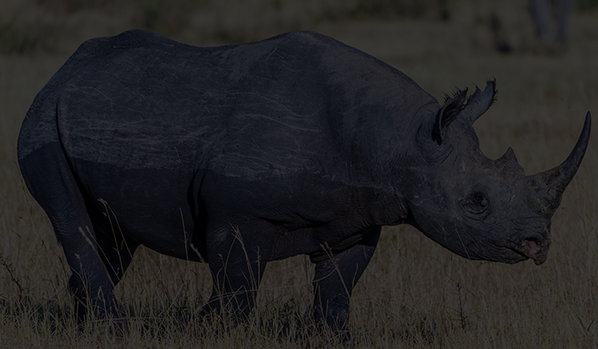

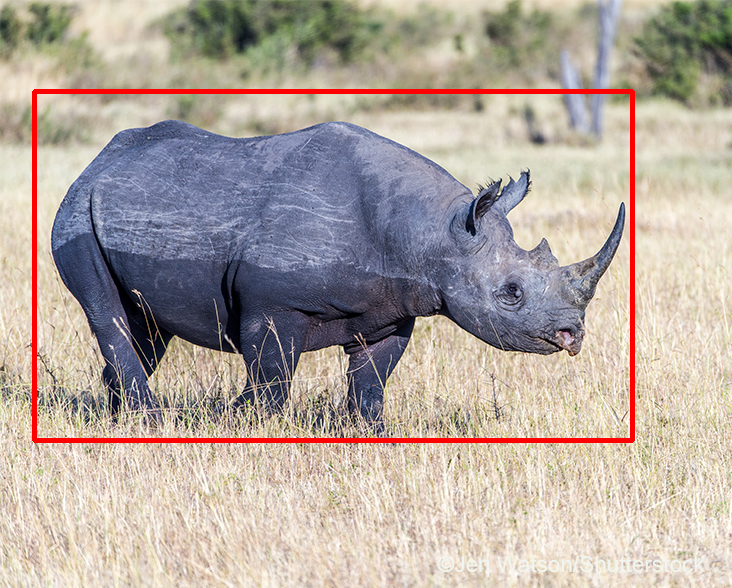

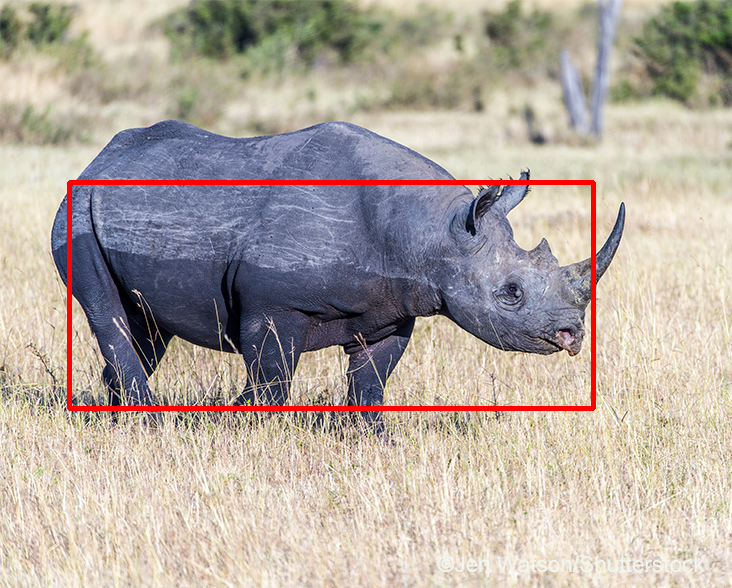

In [28]:
img = cv.imread("../data/rhino.jpg")
obj = cv.imread("../data/rhino_sample_brightness.png")
show_image(img)
show_image(obj)
simple_detector.detect(img, obj)
orb_detector.detect(img, obj)

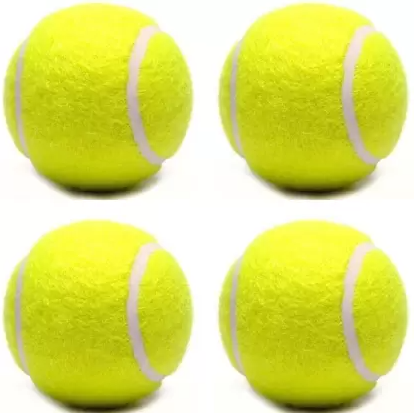

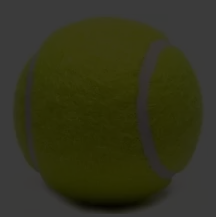

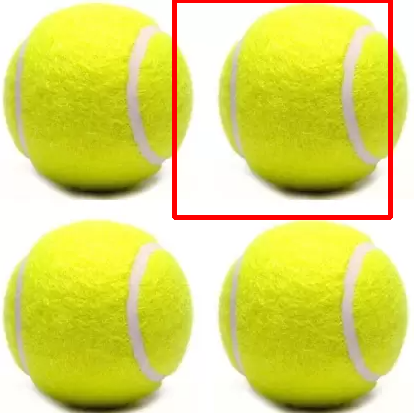

error: OpenCV(4.6.0) D:\a\opencv-python\opencv-python\opencv\modules\core\src\batch_distance.cpp:275: error: (-215:Assertion failed) type == src2.type() && src1.cols == src2.cols && (type == CV_32F || type == CV_8U) in function 'cv::batchDistance'


In [30]:
img = cv.imread("../data/tennis.png")
obj = cv.imread("../data/tennis_ball_brightness.png")
show_image(img)
show_image(obj)
simple_detector.detect(img, obj)
orb_detector.detect(img, obj)

## Similar object

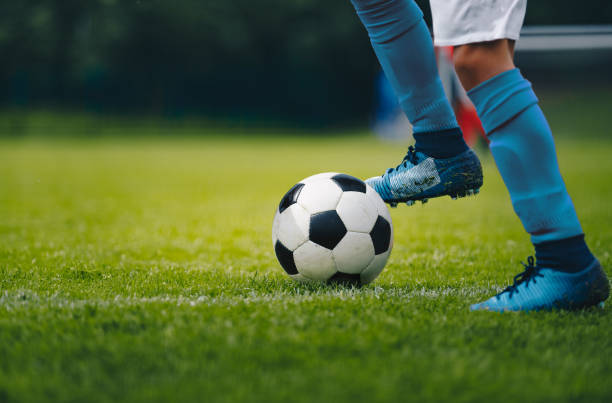

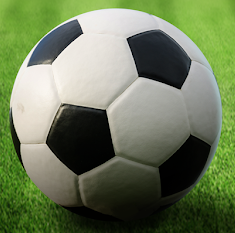

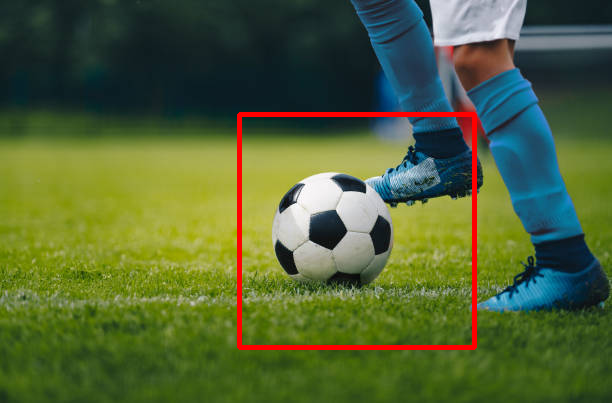

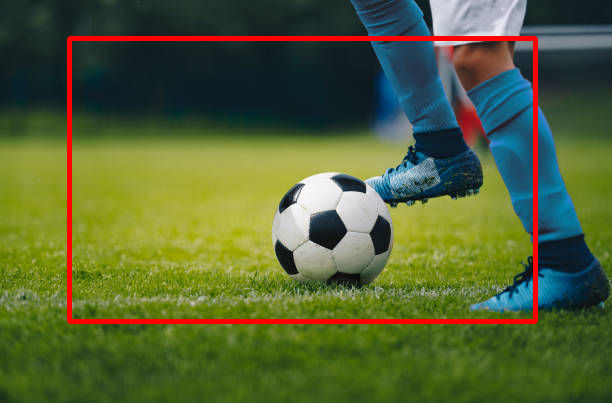

In [31]:
img = cv.imread("../data/football.jpg")
obj = cv.imread("../data/ball_other.png")
show_image(img)
show_image(obj)
simple_detector.detect(img, obj)
orb_detector.detect(img, obj)

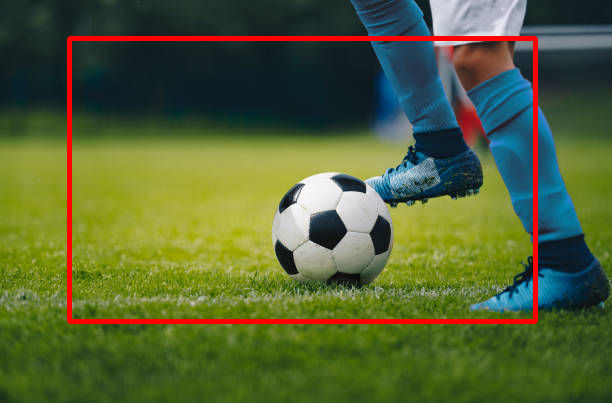

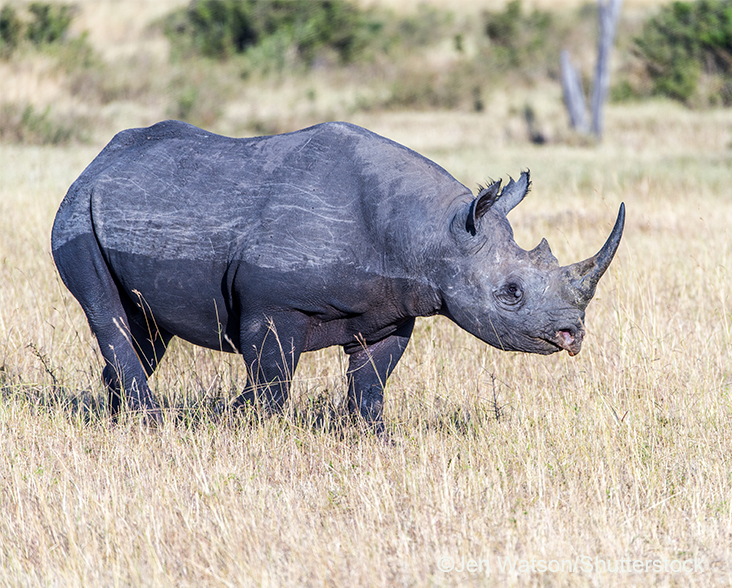

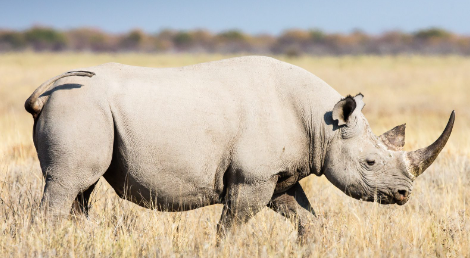

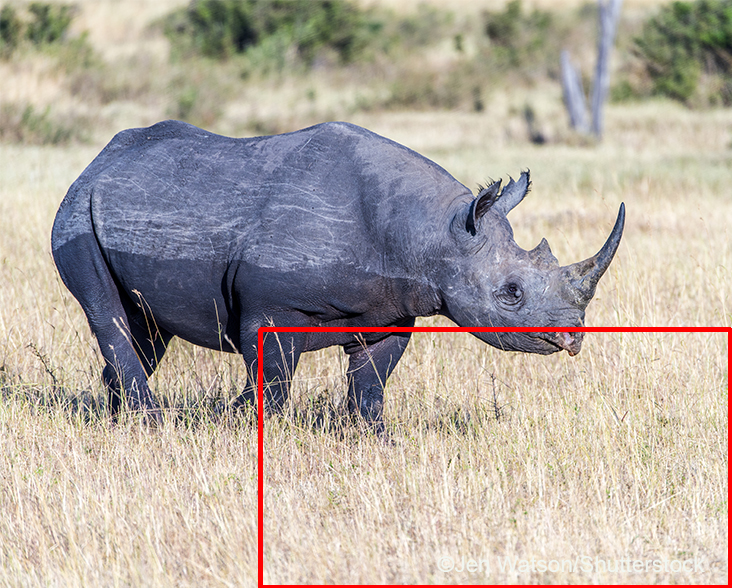

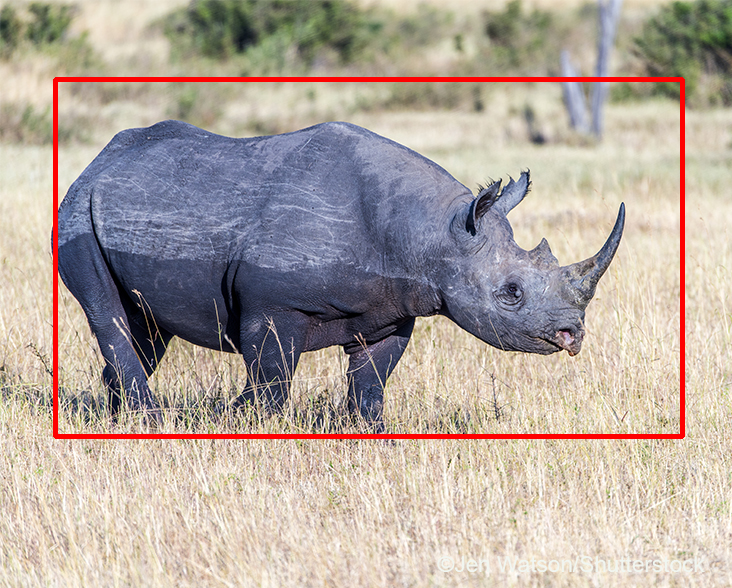

In [32]:
orb_detector.detect(img, obj)
img = cv.imread("../data/rhino.jpg")
obj = cv.imread("../data/rhino_sample_other.png")
show_image(img)
show_image(obj)
simple_detector.detect(img, obj)
orb_detector.detect(img, obj)

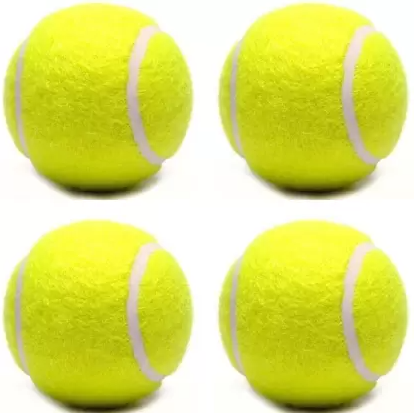

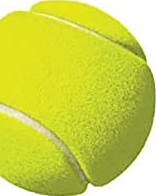

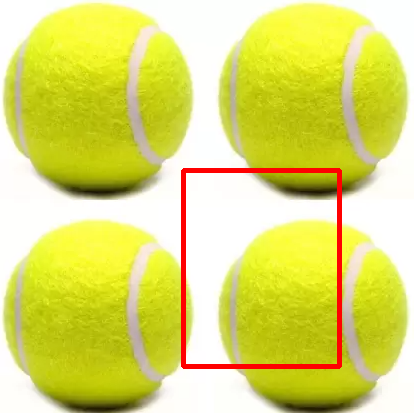

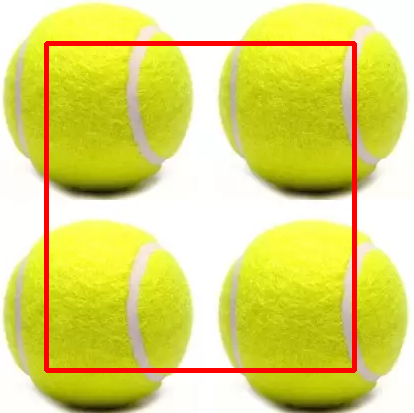

In [33]:
img = cv.imread("../data/tennis.png")
obj = cv.imread("../data/tennis_ball_other.png")
show_image(img)
show_image(obj)
simple_detector.detect(img, obj)
orb_detector.detect(img, obj)